<a href="https://colab.research.google.com/github/YoonJunHyeok/DL-Final-Project/blob/main/Final_Project_2019320107.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
import os

drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
os.chdir('/content/drive/MyDrive/COSE474')

In [ ]:
!git clone https://github.com/ultralytics/yolov5
!git clone https://github.com/YoonJunHyeok/DL-yolov5.git

fatal: destination path 'yolov5' already exists and is not an empty directory.
fatal: destination path 'DL-yolov5' already exists and is not an empty directory.


In [ ]:
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

import torch
import yaml
from IPython.display import Image, clear_output  # to display images

/content/drive/MyDrive/COSE474/yolov5
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.6/190.6 kB 5.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 51.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 646.6/646.6 kB 62.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 10.3 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
imageio 2.31.6 requires pillow<10.1.0,>=8.3.2, but you have pillow 10.1.0 which is incompatible.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 68.5/68.5 kB 2.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 8.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 9.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 9.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
data_dir = '/content/drive/MyDrive/COSE474/dataset/road_traffic'
data_yaml = '/content/drive/MyDrive/COSE474/dataset/road_traffic/data.yaml'

In [ ]:
with open(data_yaml) as f:
    film = yaml.load(f, Loader=yaml.FullLoader)
    display(film)

{'names': ['bicycles',
  'buses',
  'crosswalks',
  'fire hydrants',
  'motorcycles',
  'traffic lights',
  'vehicles'],
 'nc': 7,
 'train': '/content/drive/MyDrive/COSE474/dataset/road_traffic/train/images',
 'val': '/content/drive/MyDrive/COSE474/dataset/road_traffic/test/images'}

In [ ]:
film['train'] = '/content/drive/MyDrive/COSE474/dataset/road_traffic/train/images'
film['test'] = '/content/drive/MyDrive/COSE474/dataset/road_traffic/test/images'

with open(data_yaml, 'w') as f:
    yaml.dump(film, f)

print('변경된 yaml 파일 :')
with open(data_yaml) as f:
    film = yaml.load(f, Loader=yaml.FullLoader)
    display(film)

변경된 yaml 파일 :


{'names': ['bicycles',
  'buses',
  'crosswalks',
  'fire hydrants',
  'motorcycles',
  'traffic lights',
  'vehicles'],
 'nc': 7,
 'test': '/content/drive/MyDrive/COSE474/dataset/road_traffic/test/images',
 'train': '/content/drive/MyDrive/COSE474/dataset/road_traffic/train/images',
 'val': '/content/drive/MyDrive/COSE474/dataset/road_traffic/test/images'}

Here, we are able to pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** Our dataset locaiton is saved in the `dataset.location`
- **weights:** specify a path to weights to start transfer learning from. Here we choose the generic COCO pretrained checkpoint.
- **cache:** cache images for faster training

In [ ]:
!python train.py --img 416 --batch 128 --epochs 150 --data {data_yaml} --weights yolov5s.pt --cache

2023-12-03 08:40:57.593959: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-12-03 08:40:57.594028: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-12-03 08:40:57.594071: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=yolov5s.pt, cfg=, data=/content/drive/MyDrive/COSE474/dataset/road_traffic/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=150, batch_size=128, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [ ]:
# test image
test_data_dir = film['test']
print(test_data_dir)

/content/drive/MyDrive/COSE474/dataset/road_traffic/test/images


In [ ]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 416 --conf 0.1 --source {test_data_dir}

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/drive/MyDrive/COSE474/dataset/road_traffic/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-247-g3f02fde Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7029004 parameters, 0 gradients, 15.8 GFLOPs
image 1/133 /content/drive/MyDrive/COSE474/dataset/road_traffic/test/images/1653344614275_jpg.rf.10b450f4510e67b5ded8f29c96ceb18f.jpg: 416x416 3 crosswalkss, 7 traffic lightss, 1 vehicles, 7.7ms
image 2/133 /content/drive/MyDrive/COSE474/dataset/road_traffic/test/images/1653344650706_jp

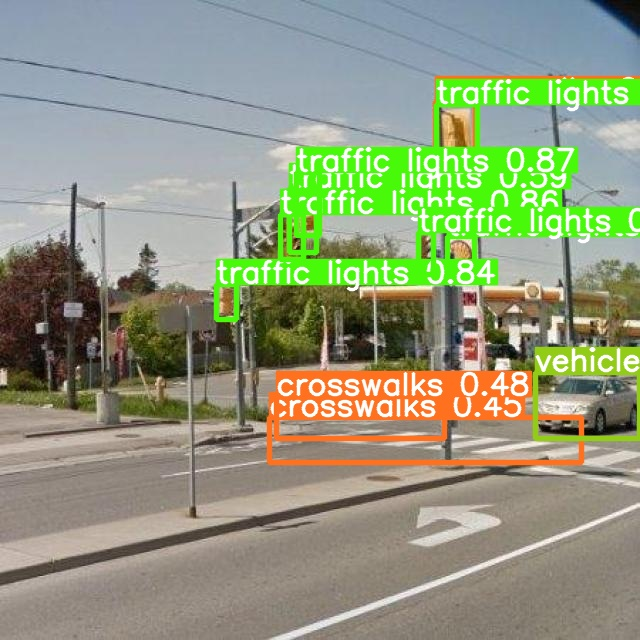

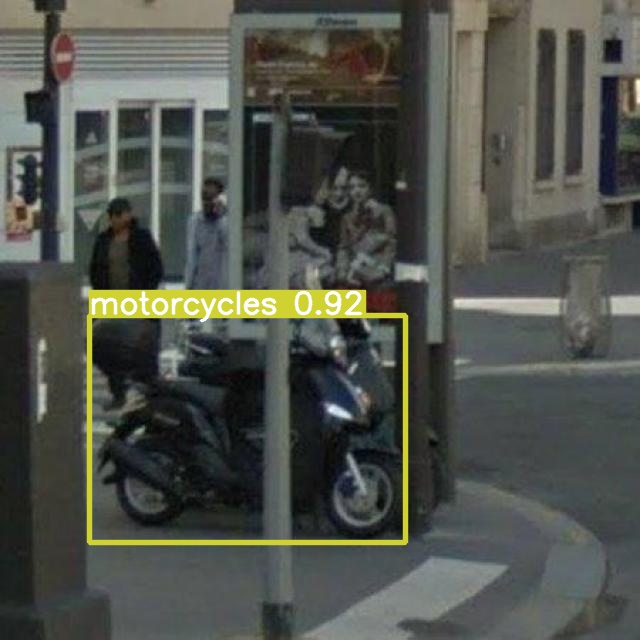

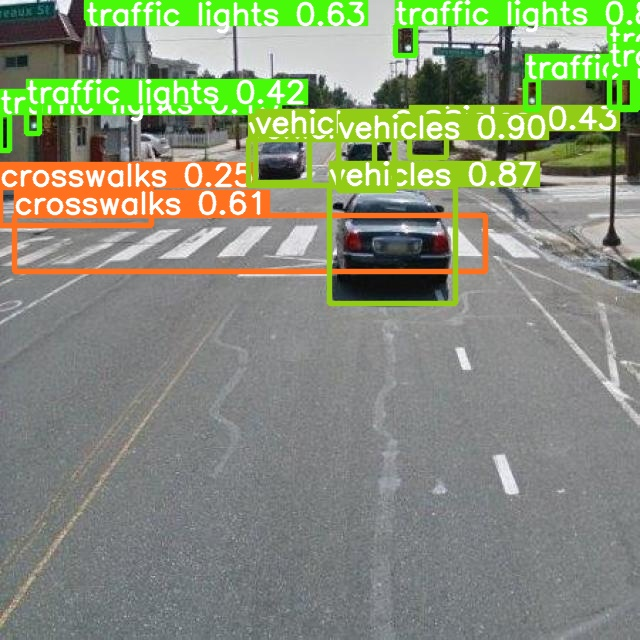

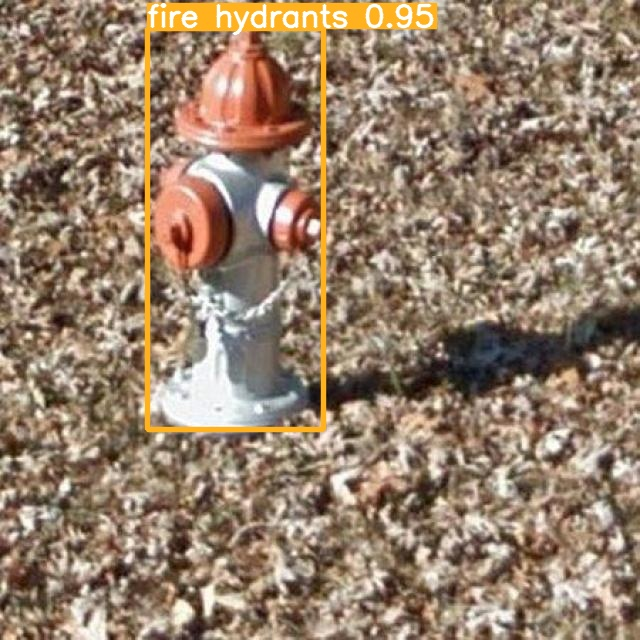

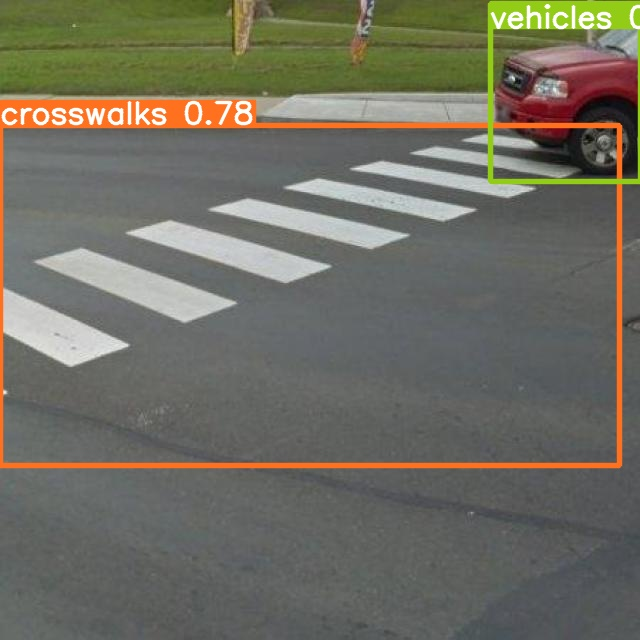

...

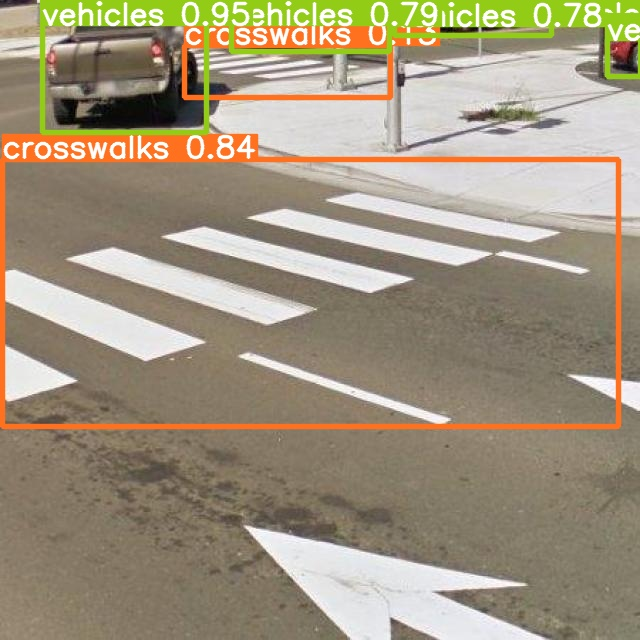

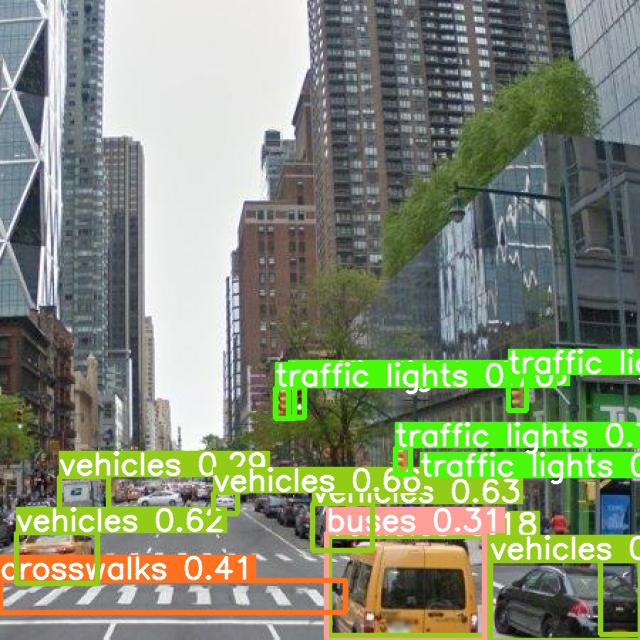

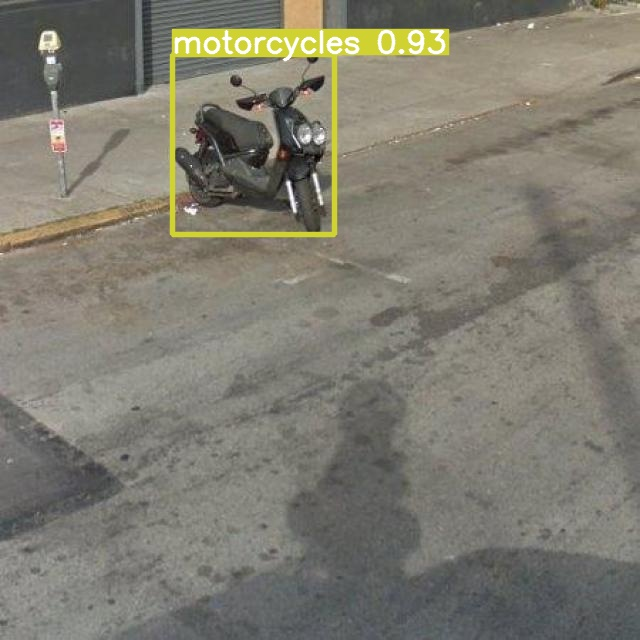

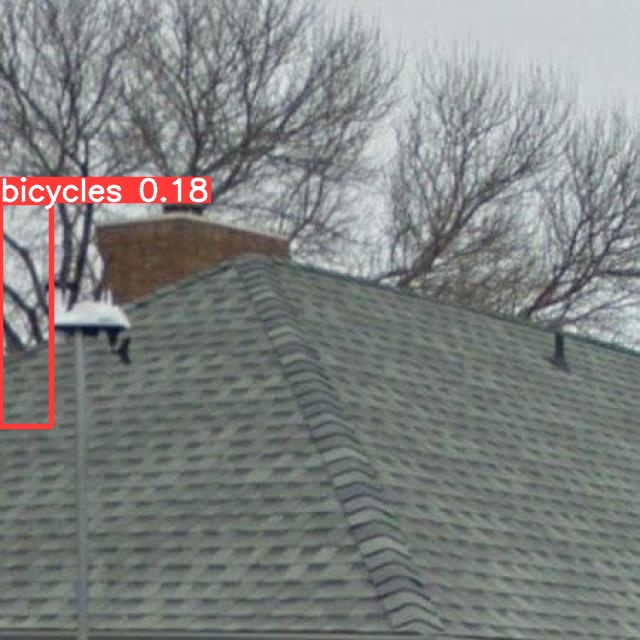

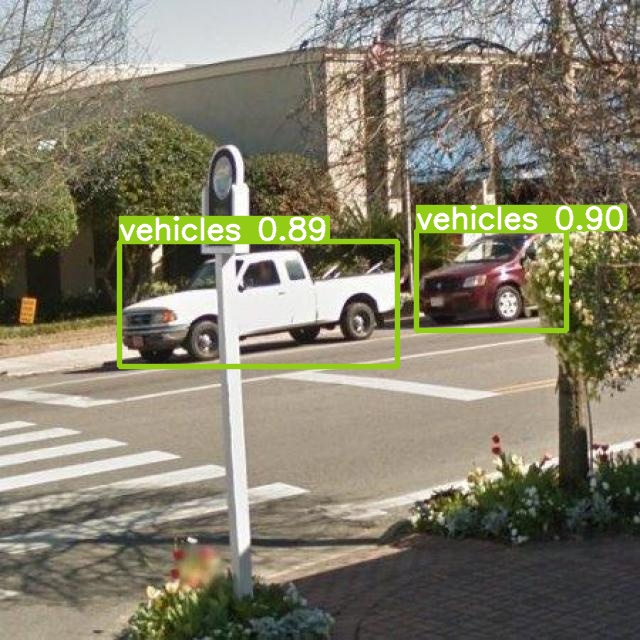

In [ ]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/drive/MyDrive/COSE474/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [22]:
# calculate mAP of original yolov5
!python val.py --weights runs/train/exp/weights/best.pt --data ../dataset/road_traffic/data.yaml  --task test --img 416

val: data=../dataset/road_traffic/data.yaml, weights=['runs/train/exp/weights/best.pt'], batch_size=32, imgsz=416, conf_thres=0.001, iou_thres=0.6, max_det=300, task=test, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-247-g3f02fde Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7029004 parameters, 0 gradients, 15.8 GFLOPs
test: Scanning /content/drive/MyDrive/COSE474/dataset/road_traffic/test/labels.cache... 133 images, 7 backgrounds, 0 corrupt: 100% 133/133 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 5/5 [00:05<00:00,  1.14s/it]
                   all        133        506      0.776      0.674      0.715      0.429
              bicycles        133         22      0.817      0.864      0.815

In [ ]:
os.chdir('/content/drive/MyDrive/COSE474')
%cd DL-yolov5 # custom yolov5 that does additional data augmentation
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

import torch
import yaml
from IPython.display import Image, clear_output  # to display images